## Set Up Environment

In [137]:
from PIL import Image
from utils import *

#### Play with Inspect

In [138]:
import inspect
src = inspect.getsource(load_image)
print(src)

def load_image(img_path):
    """Load image into a 3D numpy array
    Arg:
        img_path: string, file path of the image file.
    Return:
        imArr: numpy array with shape (height, width, 3).
    """
    #return img_path
    im = Image.open(img_path).convert('RGB') #as im:
    #print(im.size)
    #s()
    imArr = np.frombuffer(im.tobytes(), dtype=np.uint8)
    imArr = imArr.reshape((im.size[1], im.size[0], 3))
    return imArr



#### Play With Pillow

In [139]:
img_path = 'imgs/Figure1.png'
print("Loading",img_path)

Loading imgs/Figure1.png


In [145]:
im = Image.open(img_path).convert('RGB')
imArr = np.frombuffer(im.tobytes(), dtype=np.uint8)
imArr = imArr.reshape((im.size[1], im.size[0], 3))
newimArr = np.stack( (imArr[:,:,2], imArr[:,:,1], imArr[:,:,0]), axis = -1)
newim = Image.fromarray(np.uint8(newimArr))

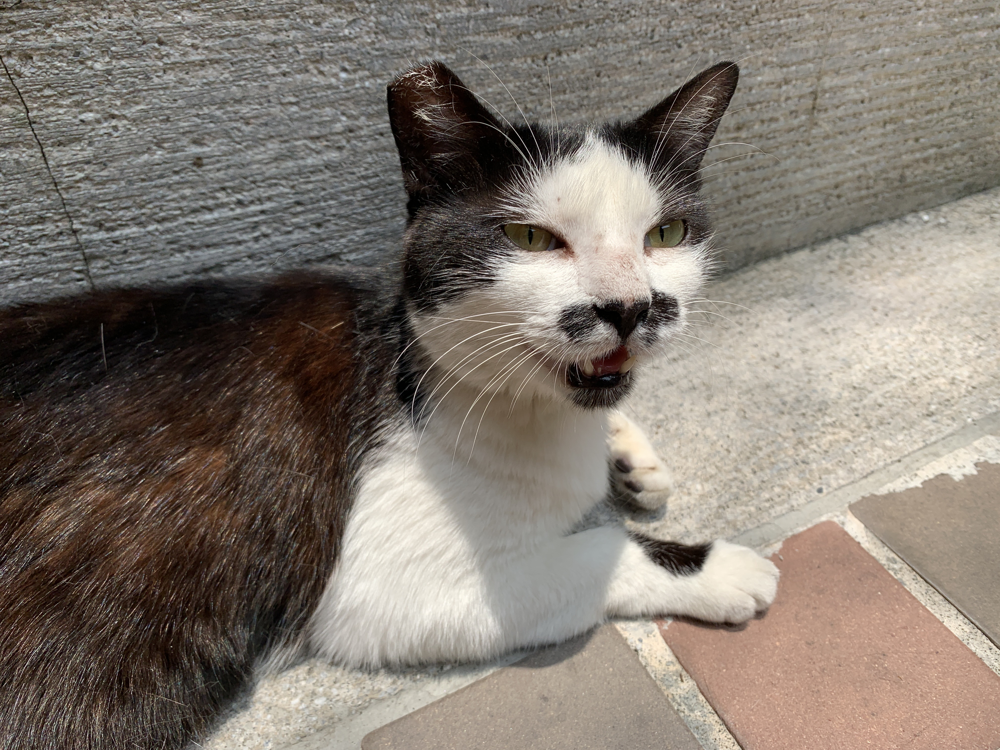

In [143]:
im

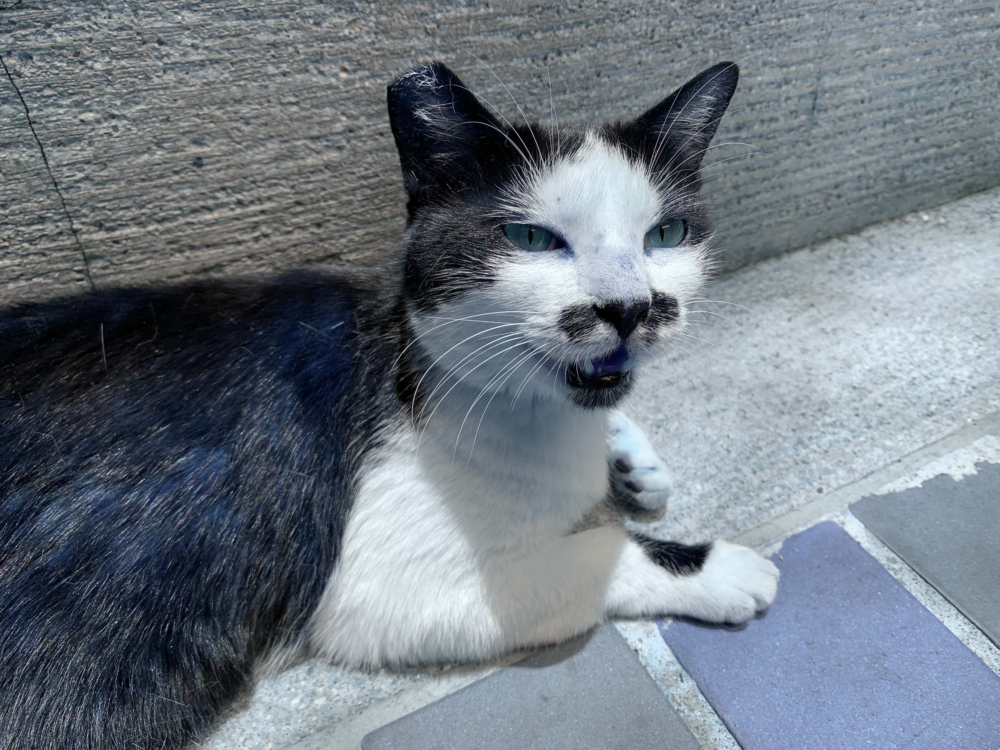

In [146]:
newim

#### Play with numpy svd
- https://numpy.org/doc/1.17/reference/generated/numpy.linalg.svd.html

In [171]:
X = np.random.normal(size=[20,18])
P, D, Q = np.linalg.svd(X, full_matrices=True)
k = 18
P_k = P[:,:k]
D_k = np.diag(D[:k])
Q_k = Q[:k, :]
X_a = np.dot(np.dot(P_k, D_k), Q_k)
print(np.std(X), np.std(X_a), np.std(X - X_a))

1.0313255608521301 1.03132556085213 1.6870189213279433e-15


In [172]:
X = np.random.normal(size=[20,18])
P, D, Q = np.linalg.svd(X, full_matrices=False)
X_a = np.matmul(np.matmul(P, np.diag(D)), Q)
print(np.std(X), np.std(X_a), np.std(X - X_a))

0.9767407145446648 0.976740714544664 2.447705907287081e-15


# Run

In [173]:
!python main.py

images in folder
	 imgs/Figure3.png
	 imgs/.ipynb_checkpoints
	 imgs/Figure2.png
	 imgs/Figure1.png
	 imgs/Figure5.png
	 imgs/Figure4.png
Loading imgs/Figure1.png
imArr size (3024, 4032, 3)
Perform SVD for k=1 ...
err 0.19299588129952436
Perform SVD for k=5 ...
err 0.11560564896947423
Perform SVD for k=50 ...
err 0.07150984495753634
Perform SVD for k=150 ...
err 0.053958598858020776
Perform SVD for k=400 ...
err 0.03284914794125227
Perform SVD for k=600 ...
err 0.023911154692669235
Perform SVD for k=800 ...
err 0.018307852720750483
Perform SVD for k=1050 ...
err 0.013852685796850358
Perform SVD for k=1200 ...
err 0.011887999098970595
